In [ ]:
# Для работы с массивами и отображением
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
from PIL import Image
from scipy import ndimage

# для загрузки из интернета
from skimage import io
import seaborn as sb

# version=4.10.0
import cv2
import cv2 as cv

# специальная утилита для отображения картинок в colab
# from google.colab.patches import cv2_imshow

#  Пример с изображением улицы

In [28]:
def convert_to_grayscale(path, url=False):
    """Конвертирует изображение в оттенки серого. """
    # для url ссылок должен использоваться другой метод загрузки
    if not url:
        # Загрузка изображения
        image = Image.open(path)  # Открываем изображение с использованием PIL (без url)
    else:
        image = image = io.imread(path)

    image = np.asarray(image)  # Преобразуем изображение в массив numpy

    # Преобразование BGR в градации серого
    # Используем стандартные коэффициенты для преобразования цветного изображения в градации серого
    r, g, b = image[..., 2], image[..., 1], image[..., 0]  # Извлечение каналов (предполагается формат BGR)
    image = 0.2989 * r + 0.5870 * g + 0.1140 * b  # Преобразование в градации серого

    return image

image = convert_to_grayscale('street.jpg')

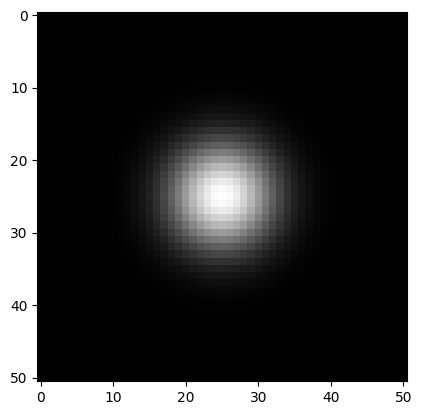

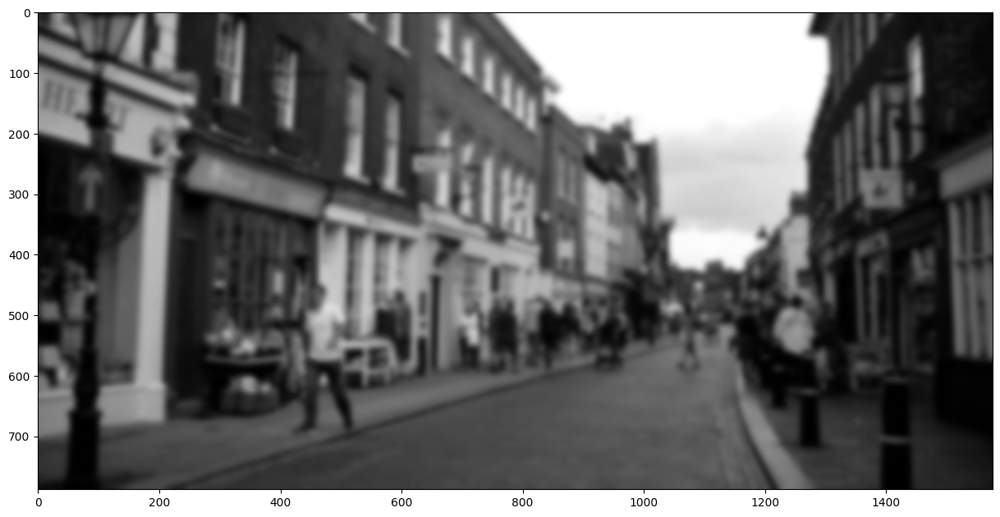

In [29]:
def filter_with_gaussian(image):
    """Фильтрует изображение с использованием гауссовского фильтра. """
    # Создание ядра/фильтра (гауссовский фильтр)
    sigma = 5  # Параметр размытия
    filter_size = (50, 50)  # Размер фильтра (ширина, высота)
    size_y = filter_size[0] // 2  # Половина высоты фильтра
    size_x = filter_size[1] // 2  # Половина ширины фильтра

    # Создание сетки координат для ядра фильтра
    x, y = np.mgrid[-size_y:size_y+1, -size_x:size_x+1]  # Массивы координат x и y
    normal = 1 / (2.0 * np.pi * sigma**2)  # Нормализующий коэффициент
    gaussian_filter = np.exp(-((x**2 + y**2) / (2.0 * sigma**2))) * normal  # Формула для гауссовского фильтра

    # Применение свёртки (размытие изображения)
    filtered = ndimage.convolve(image, gaussian_filter)  # Свёртка изображения с гауссовским фильтром
    filtered = filtered.astype('uint8')  # Приведение к целочисленному типу для отображения

    # Отображение результатов
    plt.gray()  # Установка цветовой схемы для отображения в градациях серого

    # Визуализация гауссовского фильтра
    plt.imshow(gaussian_filter)  # Отображение фильтра
    plt.show()  # Показ графика

    plt.figure(figsize=(15, 9))
    plt.imshow(filtered)

    return filtered

filtered = filter_with_gaussian(image)

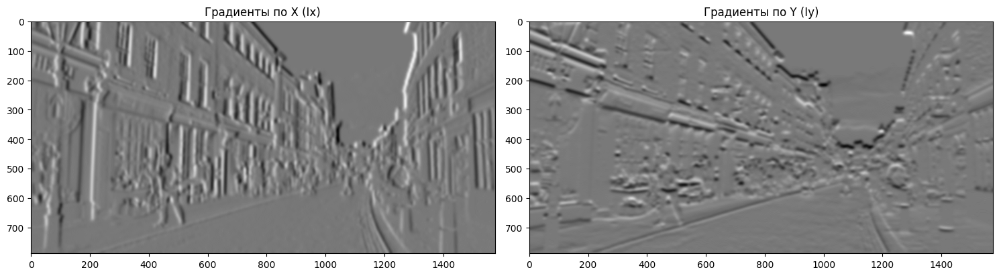

In [30]:
def calculate_sobel(filtered_image):
    """Вычисление градиентов с использованием фильтров Собеля. """
    # Горизонтальный фильтр Собеля (Kx) для вычисления градиентов по оси X
    Kx = np.array(
        [[-1, 0, 1],
        [-2, 0, 2],
        [-1, 0, 1]], np.float32
    )

    # Вертикальный фильтр Собеля (Ky) для вычисления градиентов по оси Y
    Ky = np.array(
        [[1, 2, 1],
        [0, 0, 0],
        [-1, -2, -1]], np.float32
    )

    # Нормализация изображения (деление на 255 для перевода значений в диапазон 0-1)
    filtered_image = filtered_image / 255

    # Применение горизонтального фильтра (Kx) для получения градиентов по X
    Ix = ndimage.convolve(filtered_image, Kx)

    # Применение вертикального фильтра (Ky) для получения градиентов по Y
    Iy = ndimage.convolve(filtered_image, Ky)

    # Визуализация результатов
    plt.figure(figsize=(15, 9))
    plt.subplot(121)
    plt.imshow(Ix)  # Отображение горизонтальных градиентов
    plt.title("Градиенты по X (Ix)")

    plt.subplot(122)
    plt.imshow(Iy)  # Отображение вертикальных градиентов
    plt.title("Градиенты по Y (Iy)")

    plt.tight_layout()
    plt.show()

    return Ix, Iy

Ix, Iy = calculate_sobel(filtered)

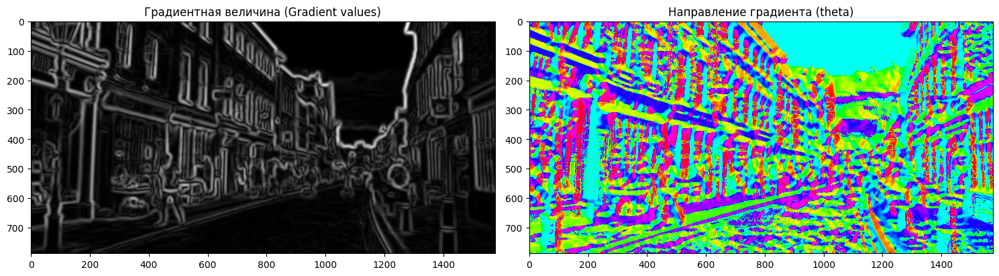

In [31]:
def calculate_gradient_values(Ix, Iy):
    """Вычисление градиентной величины пикселей. """
    # Вычисление градиентной величины (G)
    # Метод 1: через квадратные корни суммы квадратов градиентов Ix и Iy
    # G = np.sqrt((Ix**2)+(Iy**2))
    '''или'''
    # Метод 2: используя np.hypot (эквивалентный расчету выше)
    Gradient = np.hypot(Ix, Iy)

    # Нормализация градиентной величины для отображения (в диапазоне от 0 до 255)
    Gradient = Gradient / Gradient.max() * 255

    # Вычисление направления градиента (theta) в радианах
    # np.arctan2 учитывает знаки Ix и Iy для определения полного направления
    theta = np.arctan2(Iy, Ix)

    # Визуализация результатов
    plt.figure(figsize=(15, 9))

    # Отображение карты градиентной величины (Gradient value)
    plt.subplot(121)
    plt.imshow(Gradient, cmap='gray')
    plt.title('Градиентная величина (Gradient values)')

    # Отображение карты направлений градиентов (theta)
    plt.subplot(122)
    plt.imshow(theta, cmap='hsv')  # Используем цветовую палитру для направлений
    plt.title('Направление градиента (theta)')

    plt.tight_layout()
    plt.show()

    return Gradient, theta

gradient_value, theta = calculate_gradient_values(Ix, Iy)

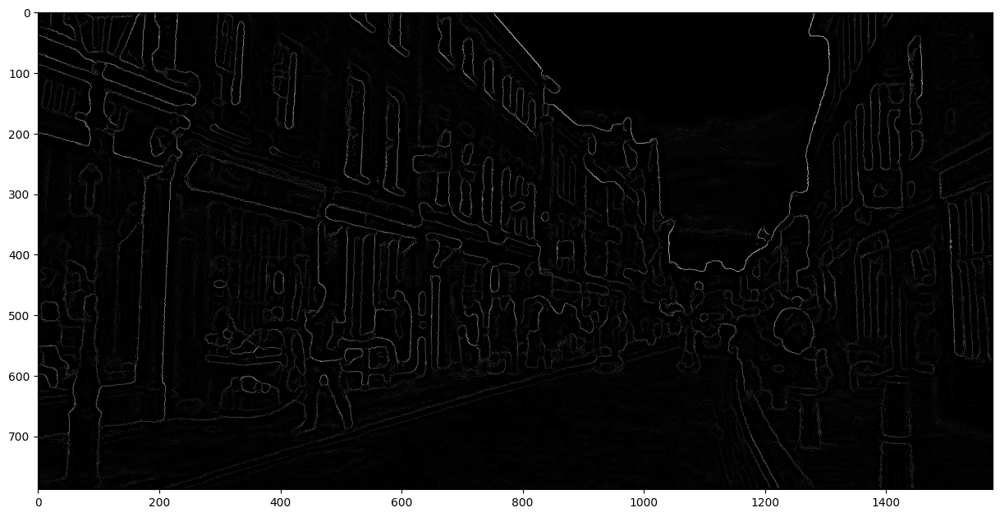

In [32]:
def non_max_suppression(gradient, theta):
    """Подавление немаксимумов (Non Max Suppression). """
    # Размеры изображения
    M, N = gradient.shape

    # Создание массива для хранения io
    result = np.zeros((M, N), dtype=np.int32)

    # Преобразование углов из радиан в градусы для удобства обработки
    angle = theta * 180. / np.pi    # Преобразование из радиан в градусы (диапазон: -180 до 180)
    angle[angle < 0] += 180         # Перевод диапазона в положительные значения (0 до 180)

    # Обход изображения (исключая границы)
    for i in range(1, M-1):
        for j in range(1, N-1):
            q = 255  # Инициализация значений q
            r = 255  # Инициализация значений r

            # Обработка направлений углов
            # Направление 0 градусов (горизонталь)
            if (0 <= angle[i, j] < 22.5) or (157.5 <= angle[i, j] <= 180):
                r = gradient[i, j-1]  # Сосед слева
                q = gradient[i, j+1]  # Сосед справа
            # Направление 45 градусов (диагональ вверх вправо)
            elif (22.5 <= angle[i, j] < 67.5):
                r = gradient[i-1, j+1]  # Сосед сверху справа
                q = gradient[i+1, j-1]  # Сосед снизу слева
            # Направление 90 градусов (вертикаль)
            elif (67.5 <= angle[i, j] < 112.5):
                r = gradient[i-1, j]  # Сосед сверху
                q = gradient[i+1, j]  # Сосед снизу
            # Направление 135 градусов (диагональ вверх влево)
            elif (112.5 <= angle[i, j] < 157.5):
                r = gradient[i+1, j+1]  # Сосед снизу справа
                q = gradient[i-1, j-1]  # Сосед сверху слева

            # Подавление немаксимумов
            if (gradient[i, j] >= q) and (gradient[i, j] >= r):  # Если текущая точка больше соседей
                result[i, j] = gradient[i, j]  # Сохраняем значение градиента
            else:
                result[i, j] = 0  # В противном случае присваиваем 0

    plt.figure(figsize=(15, 9))
    plt.imshow(result)

    return result

surprassed = non_max_suppression(gradient_value, theta)

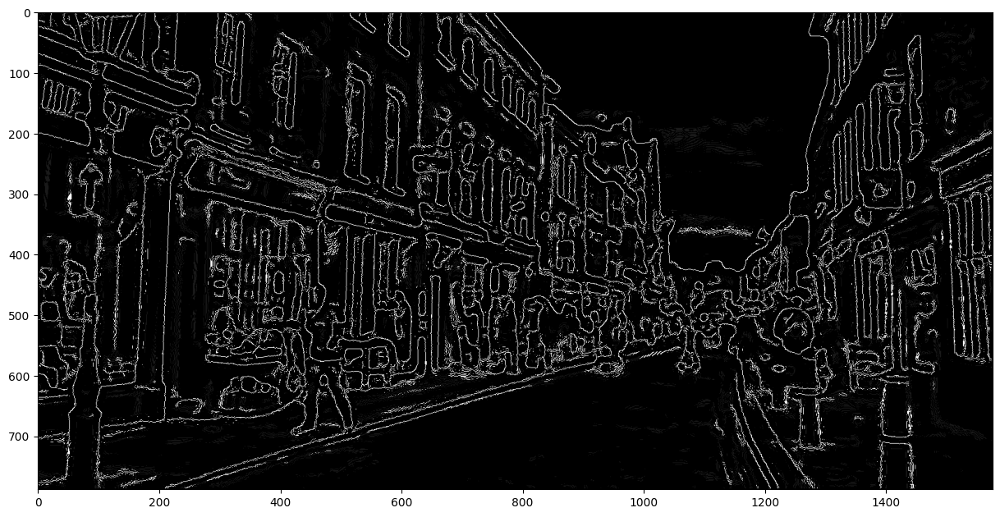

In [33]:
def threshold(img, lowThresholdRatio=0.05, highThresholdRatio=0.09):
    """Двойное пороговое преобразование (Double threshold). """
    # Вычисление порогов
    highThreshold = img.max() * highThresholdRatio  # Высокий порог (процент от максимального значения)
    lowThreshold = highThreshold * lowThresholdRatio  # Низкий порог (доля от высокого порога)

    # Размеры изображения
    M, N = img.shape

    # Инициализация результирующего изображения
    res = np.zeros((M, N), dtype=np.int32)

    # Определение значений для слабых и сильных границ
    weak = np.int32(25)  # Значение для слабых границ
    strong = np.int32(255)  # Значение для сильных границ

    # Нахождение координат пикселей:
    # Сильные границы (пиксели с интенсивностью >= highThreshold)
    strong_i, strong_j = np.where(img >= highThreshold)

    # Пиксели ниже низкого порога (порог отсева)
    zeros_i, zeros_j = np.where(img < lowThreshold)

    # Слабые границы (пиксели между низким и высоким порогами)
    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))

    # Заполнение результирующего изображения
    res[strong_i, strong_j] = strong  # Сильные границы получают значение 255
    res[weak_i, weak_j] = weak  # Слабые границы получают значение 25

    plt.figure(figsize=(15, 9))
    plt.imshow(res)

    # Возвращаем результирующее изображение и значения слабых/сильных границ
    return (res, weak, strong)

thresholded = threshold(surprassed, 0.5)[0]

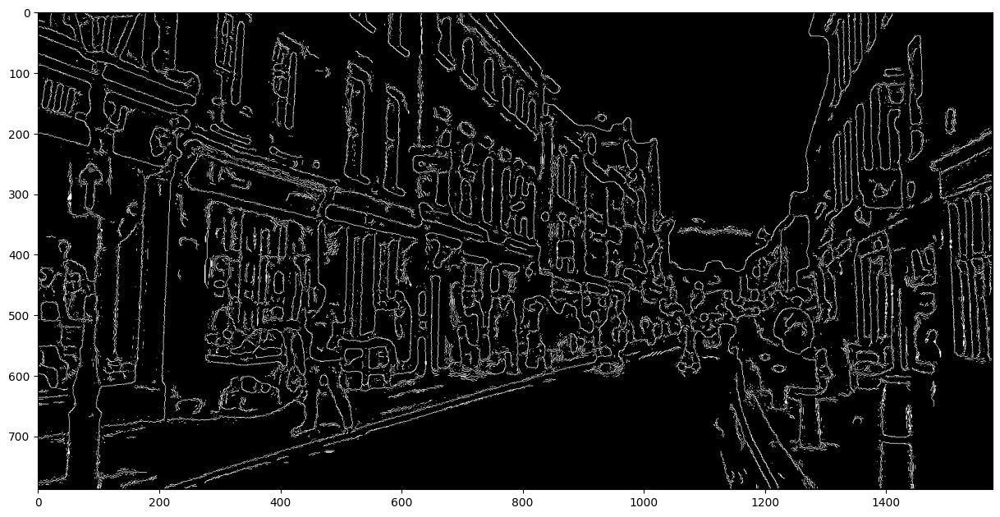

In [34]:
def hysteresis(img, weak, strong=255):
    """Гистерезисное отслеживание (Hysteresis Edge Tracking). """
    # Размеры изображения
    M, N = img.shape

    # Проход по изображению (исключаем границы, так как они не обрабатываются)
    for i in range(1, M-1):
        for j in range(1, N-1):
            # Если текущий пиксель — слабая граница
            if (img[i, j] == weak):
                # Проверяем, связана ли слабая граница с сильной (в 8-связной окрестности)
                if (
                    (img[i+1, j-1] == strong) or (img[i+1, j] == strong) or
                    (img[i+1, j+1] == strong) or (img[i, j-1] == strong) or
                    (img[i, j+1] == strong) or (img[i-1, j-1] == strong) or
                    (img[i-1, j] == strong) or (img[i-1, j+1] == strong)
                ):
                    img[i, j] = strong  # Превращаем слабую границу в сильную
                else:
                    img[i, j] = 0  # Удаляем слабую границу (не связана с сильной)

    plt.figure(figsize=(15, 9))
    plt.imshow(img)

    # Возвращаем обработанное изображение
    return img

final_image = hysteresis(thresholded,25)

#  Сверху определены основные функции для получения и детектирования границ канни

Таким образом, полный цикл обработки входного ихображения выглядит следующим образом


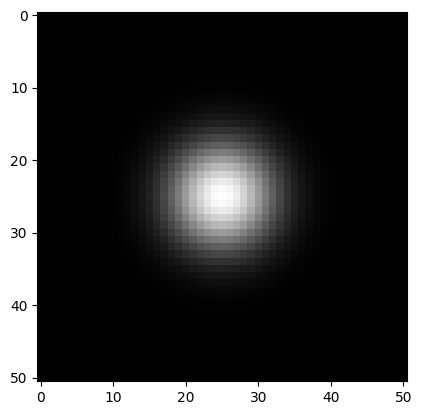

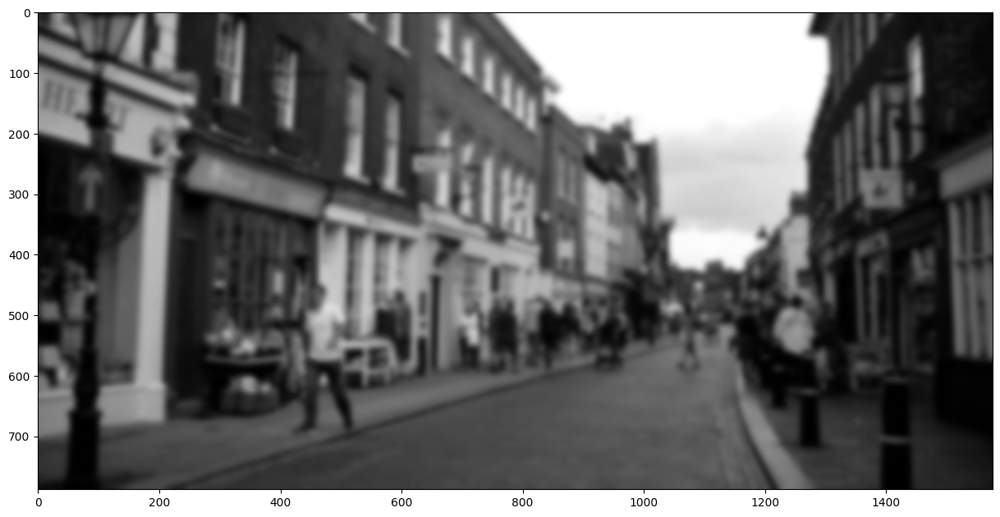

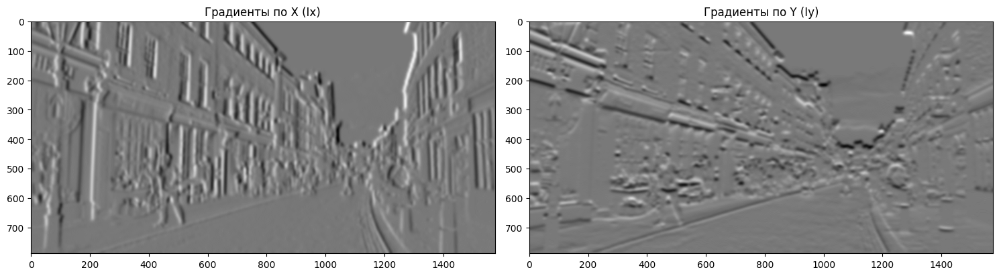

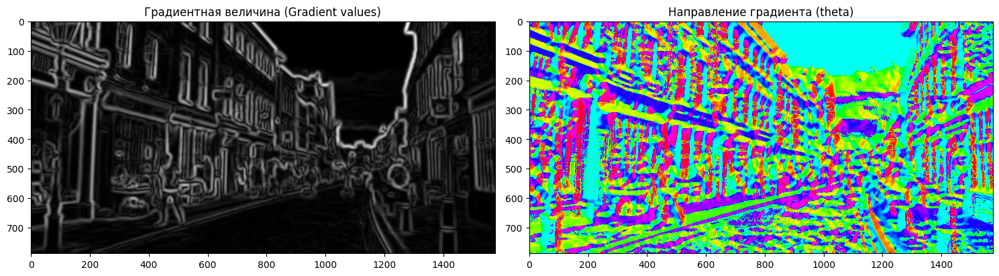

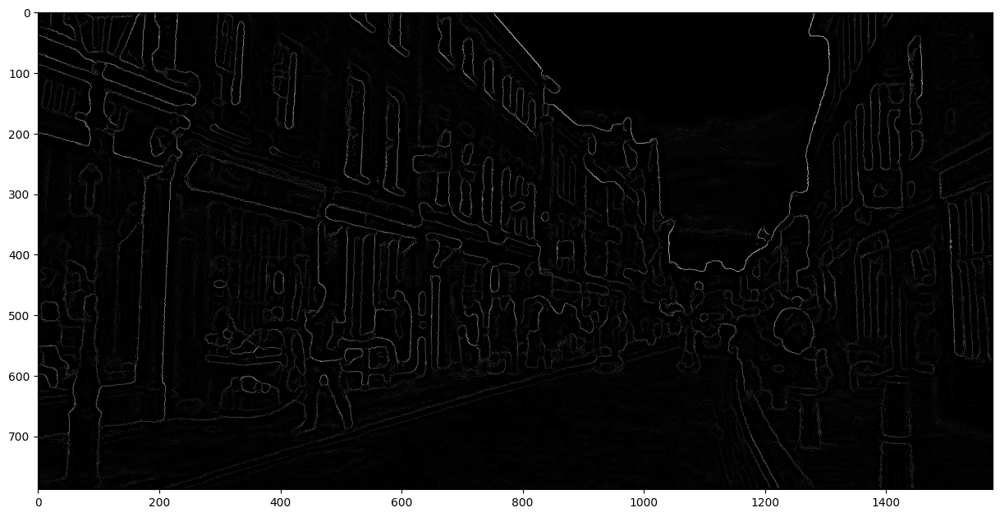

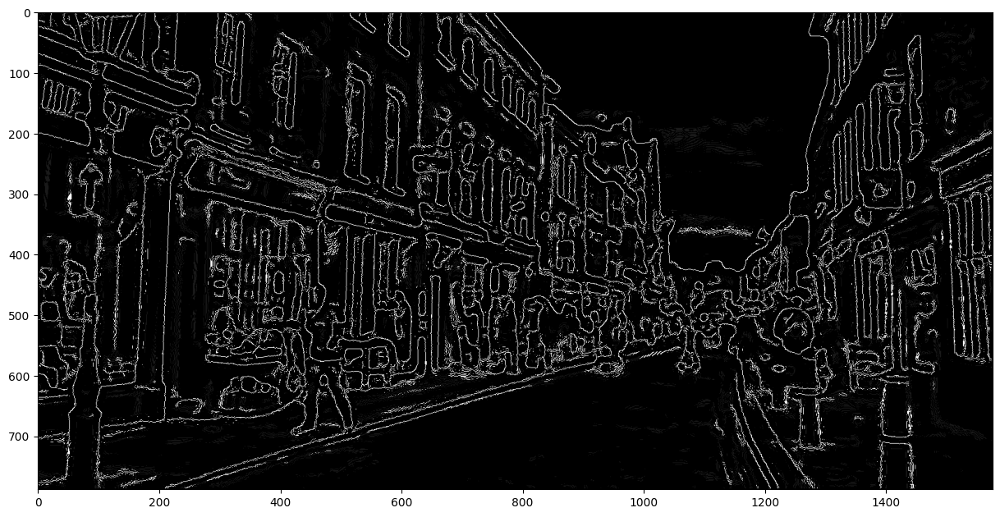

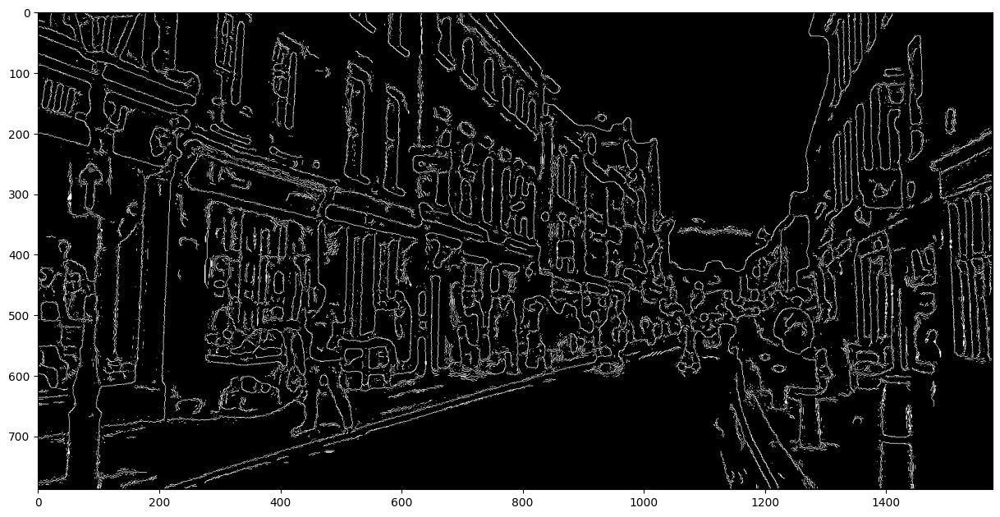

In [ ]:
# Конвертация в оттенки серого
image = convert_to_grayscale('street.jpg')

# Фильтрация через гауссовский фильтр
filtered = filter_with_gaussian(image)

# Вычисление градиентов с помощью операторов Собеля
Ix, Iy = calculate_sobel(filtered)

# Вычисление градиентной величины пикселей
gradient_value, theta = calculate_gradient_values(Ix, Iy)

# non-max подавление слабых величин
surprassed = non_max_suppression(gradient_value, theta)

# Удаление слабых границ двойным пороговым преобразованием
thresholded = threshold(surprassed, 0.5)[0]

# Получение финальных сдетектированных границ
final_image = hysteresis(thresholded,25)

In [16]:
final_image.shape

(482, 600)

# ДЗ: соберите последовательное использование описанных выше методов в одну функцию, которая на вход принимает путь к изображению и возвращает финальный результат

## картинка1: размытое фото авто, обратите внимание на функцию convert_to_grayscale и параметр url (url=True, если хотите загрузить изображение по url, False, если локально из colab папки)

In [17]:
path_to_image = "https://github.com/opencv/opencv/blob/master/samples/data/licenseplate_motion.jpg?raw=true"

https://github.com/opencv/opencv/blob/master/samples/data/licenseplate_motion.jpg?raw=true


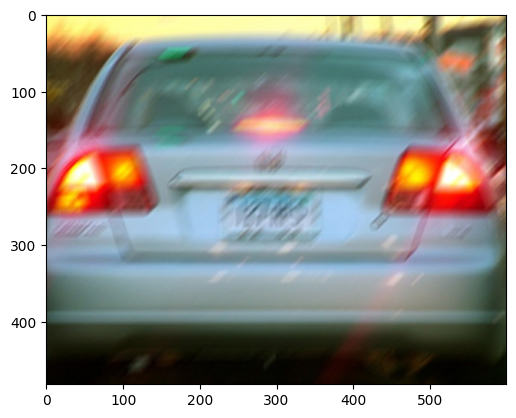

In [5]:
def load_and_show_image(path):
    # вывести на экран адрес изображения
    print(f"{path}")
    # прочитать и загрузить изображение в numpy массив image
    image = io.imread(path)
    # с помощью утилиты google.colab cv2_imshow вывести изображение
    plt.imshow(image)

load_and_show_image(path=path_to_image)

In [19]:
def compile_of_methods(path, url):
    # Конвертация в оттенки серого
    image = convert_to_grayscale(path, url)

    # Фильтрация через гауссовский фильтр
    filtered = filter_with_gaussian(image)

    # Вычисление градиентов с помощью операторов Собеля
    Ix, Iy = calculate_sobel(filtered)

    # Вычисление градиентной величины пикселей
    gradient_value, theta = calculate_gradient_values(Ix, Iy)

    # non-max подавление слабых величин
    surprassed = non_max_suppression(gradient_value, theta)

    # Удаление слабых границ двойным пороговым преобразованием
    thresholded = threshold(surprassed, 0.5)[0]

    # Получение финальных сдетектированных границ
    final_image = hysteresis(thresholded,25)

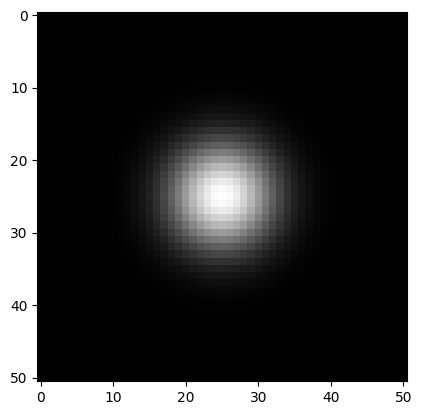

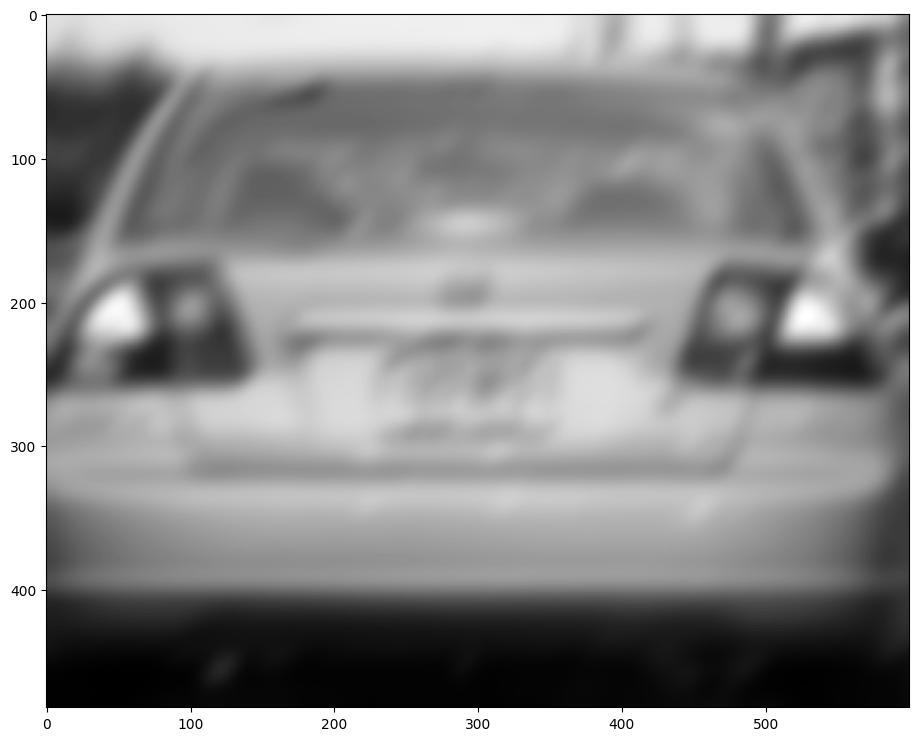

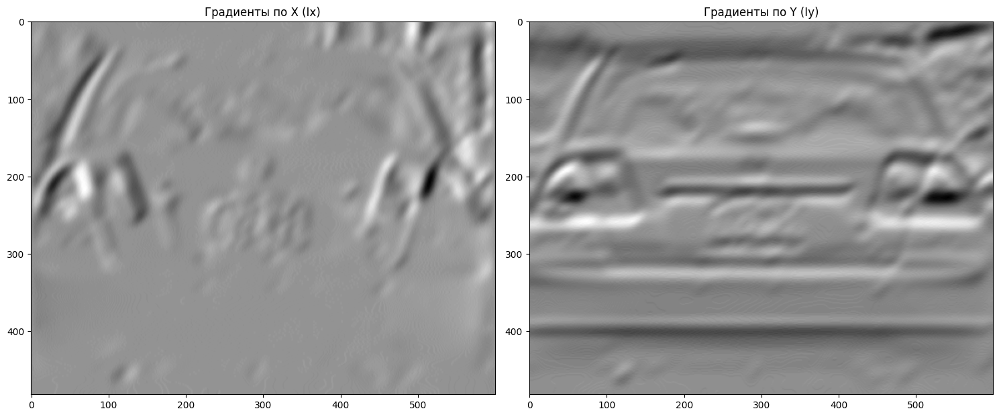

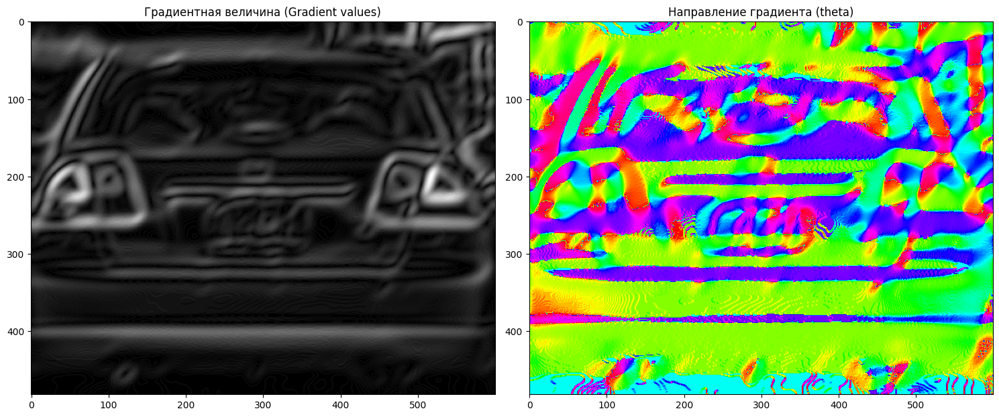

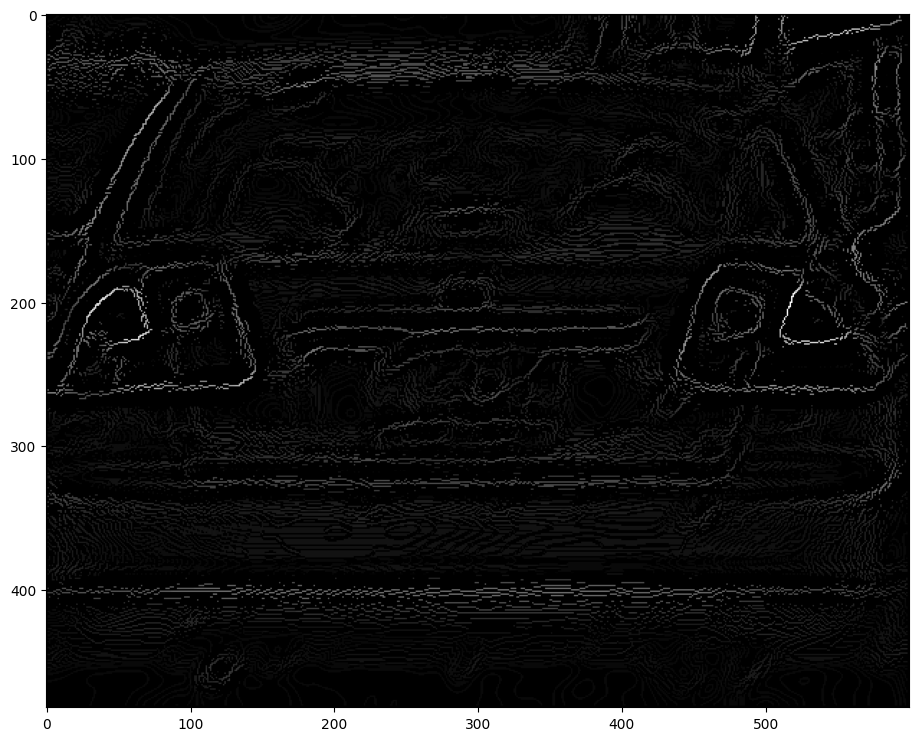

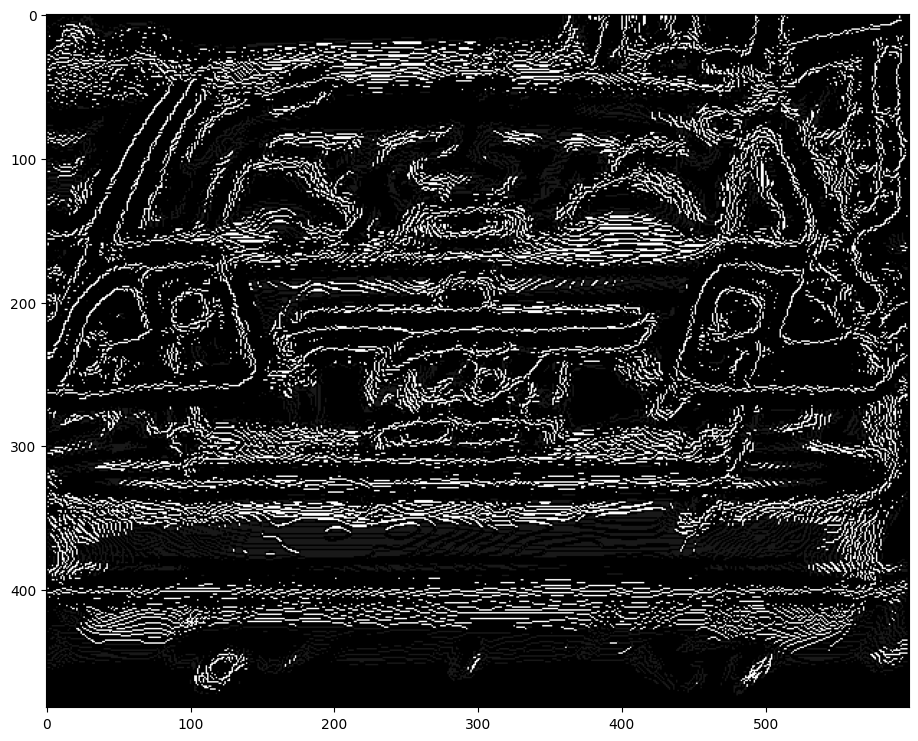

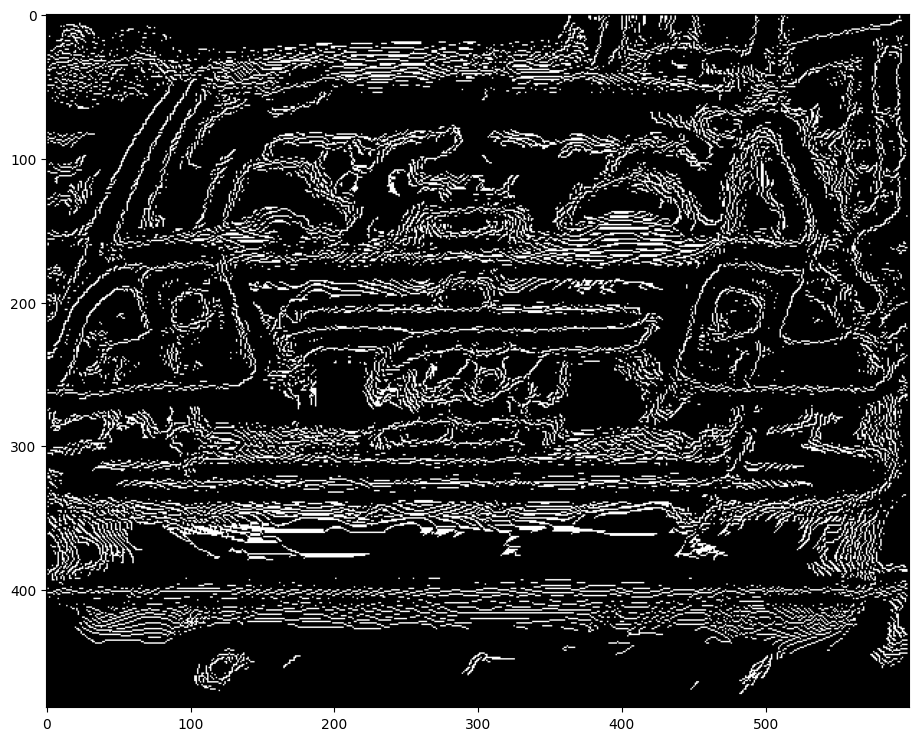

In [20]:
compile_of_methods(path=path_to_image, url=True)

## картинка2: фото стадиона (не забудьте сначала загрузить фото в папке в меню слева)

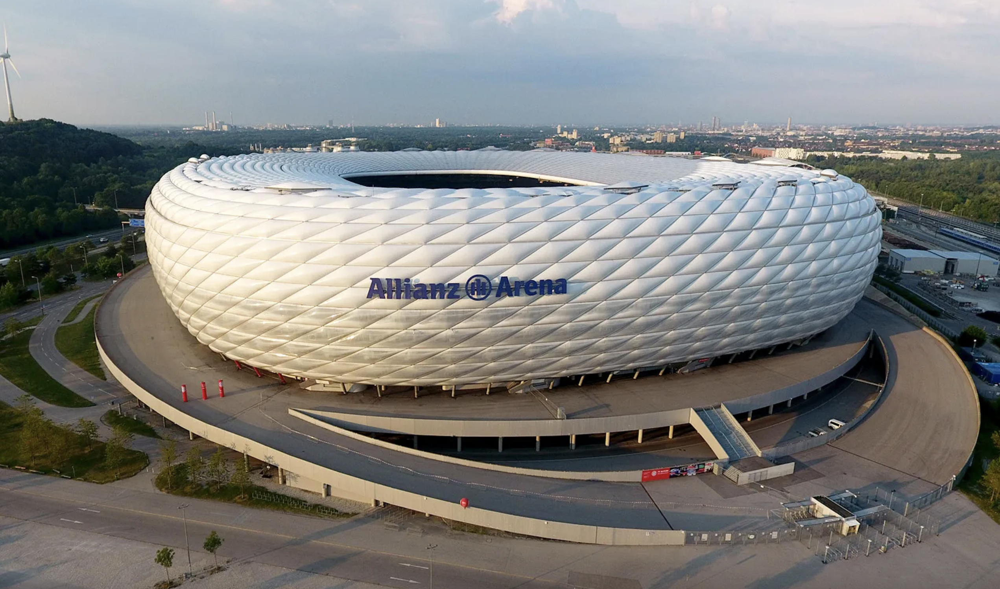

In [26]:
path = 'stadium.jpg'
# Загрузка изображения
img = Image.open(path)
display(img)

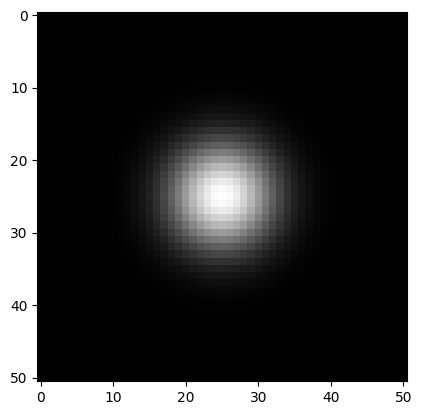

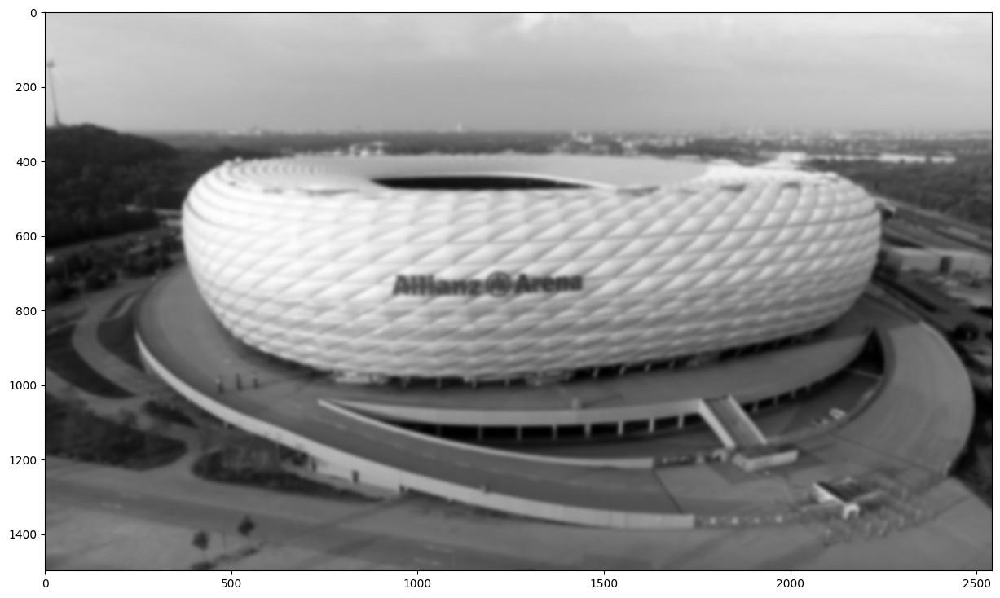

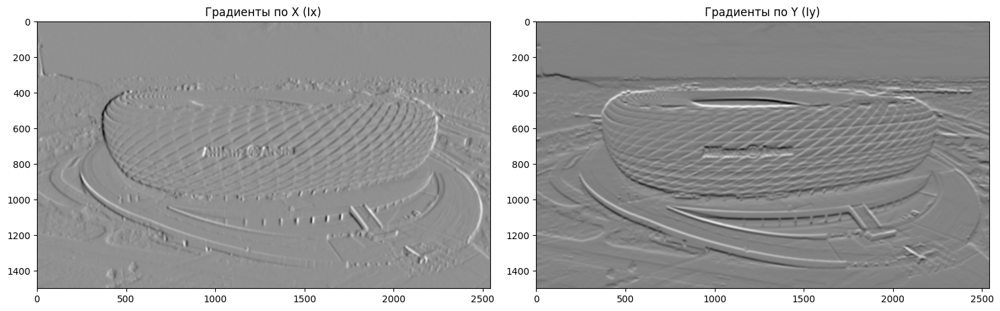

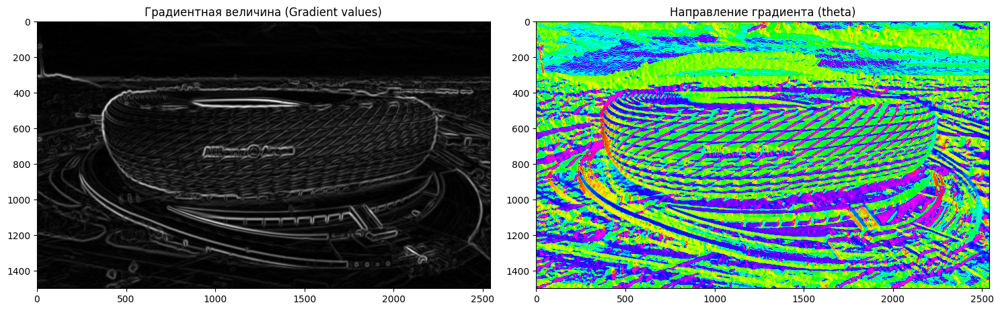

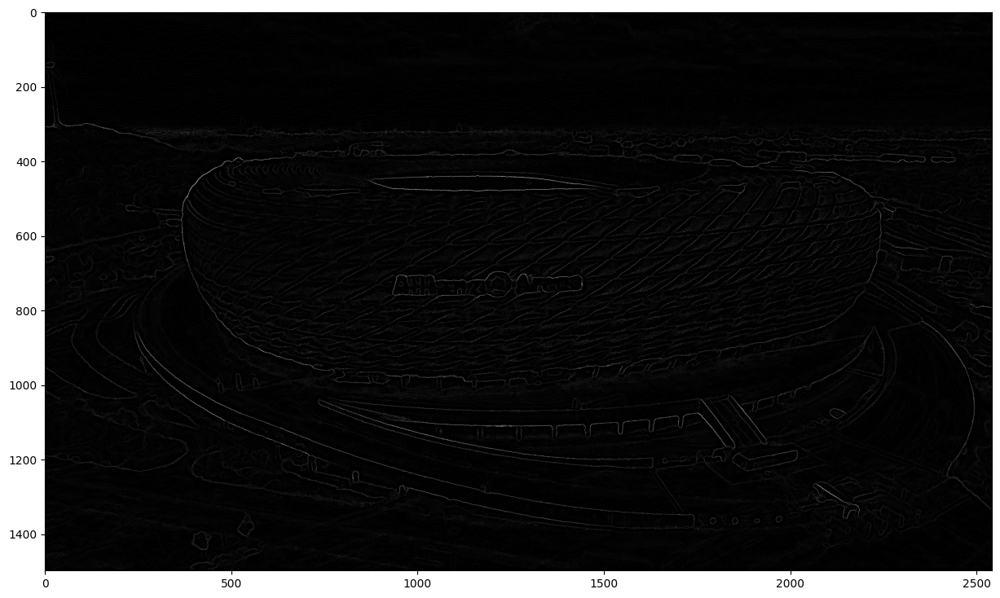

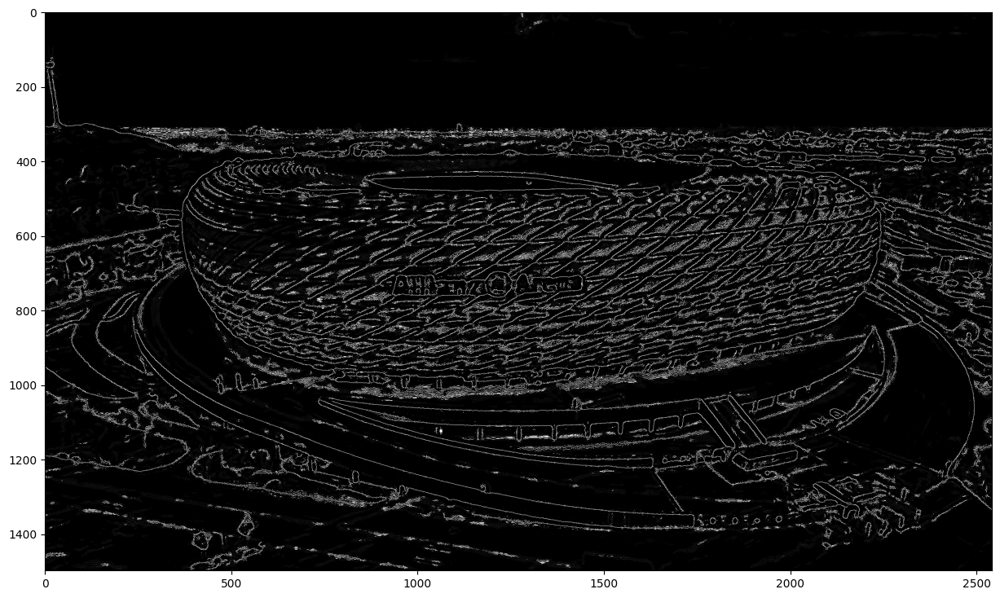

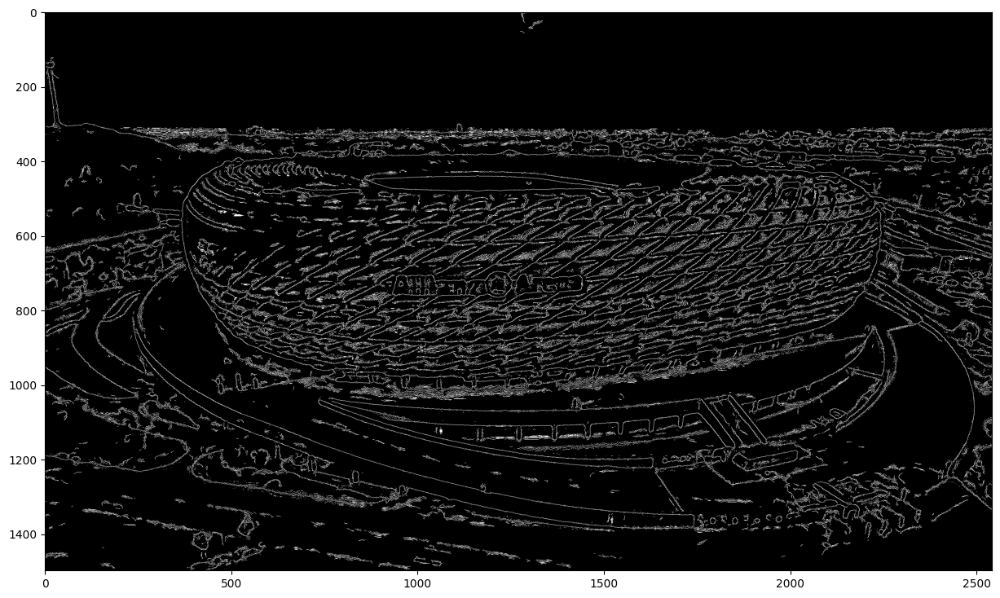

In [27]:
compile_of_methods(path=path, url=False)